In [1]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import numpy as np
import rasterio as rio
import matplotlib.pyplot as plt
import torch
from rasterio.plot import show
#import torchvision
%matplotlib inline

/cephyr/users/benvin/Alvis/.local/lib/python3.8/site-packages/torchvision/io/image.py:11: UserWarning: Failed to load image Python extension: /cephyr/users/benvin/Alvis/.local/lib/python3.8/site-packages/torchvision/image.so: undefined symbol: _ZNK3c106IValue23reportToTensorTypeErrorEv
  warn(f"Failed to load image Python extension: {e}")


In [7]:
aug_a = A.Compose([
    #A.Resize(224, 224, )
    
    A.RandomResizedCrop(224, 224, scale=(0.08, 1.0), ratio=(0.75, 1.3333333333333333)),
    A.GaussianBlur(p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    ToTensorV2()
])

aug = A.Compose([
            ToTensorV2()
        ])

band_stats = {
  "means": {
   "BLUE": 0.06614169065743208,
   "GREEN": 0.09635988259340068,
   "RED": 0.11381173286380034,
    }, 
    "stds": {
       "BLUE": 0.03512808462999218,
       "GREEN": 0.050729950158437294,
       "RED": 0.07239252056994558,
    }
}

band_stats

{'means': {'BLUE': 0.06614169065743208,
  'GREEN': 0.09635988259340068,
  'RED': 0.11381173286380034},
 'stds': {'BLUE': 0.03512808462999218,
  'GREEN': 0.050729950158437294,
  'RED': 0.07239252056994558}}

In [14]:
def index_to_year(index):
    start_year = 1990 + index*3
    end_year = start_year + 2
    return str(start_year) + "-" + str(end_year)

# Set plot size
plt.rcParams["figure.figsize"] = (20,10)

import pandas as pd

train_csv = "/cephyr/NOBACKUP/groups/globalpoverty1/JesperBenjamin/imagepathfull.csv"
image_paths = pd.read_csv(train_csv)

sample_imgs = image_paths.sample(frac=0.0003)
sample_imgs.size

41

<ipython-input-15-3ff38a7a445a>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2)


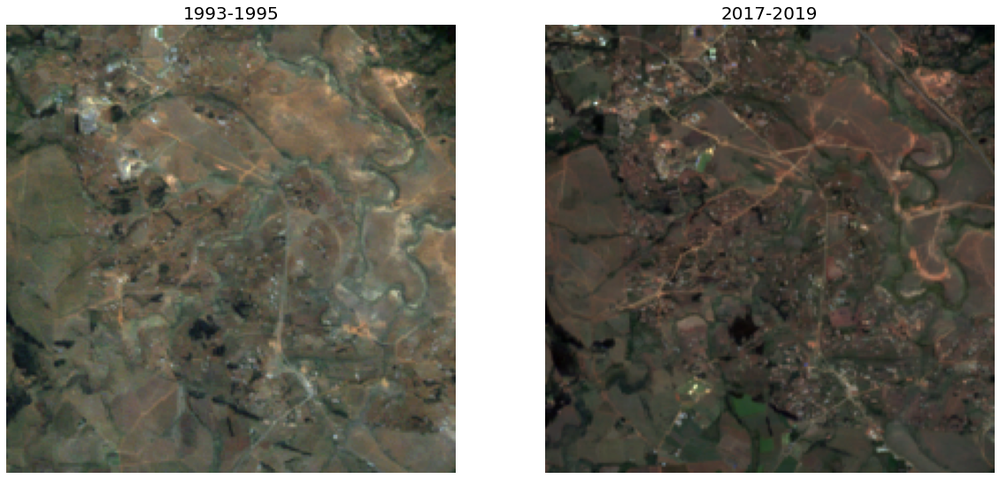

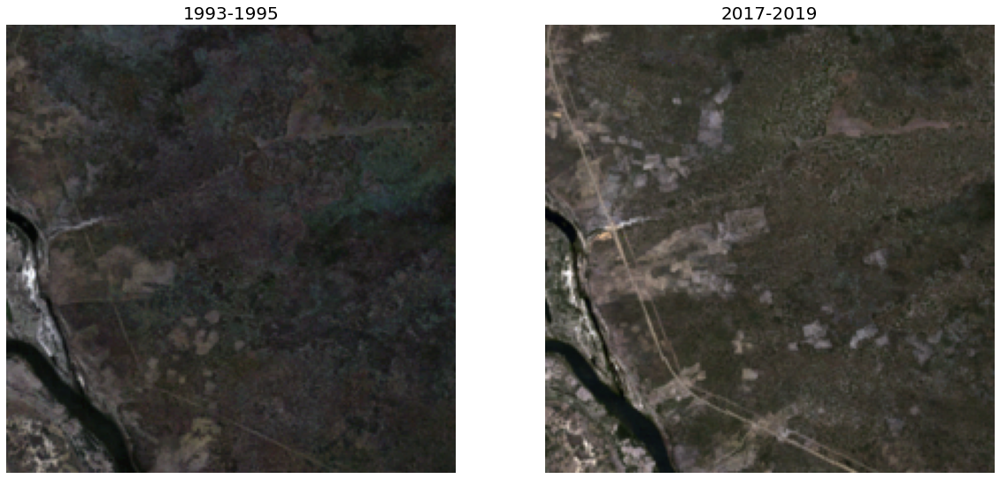

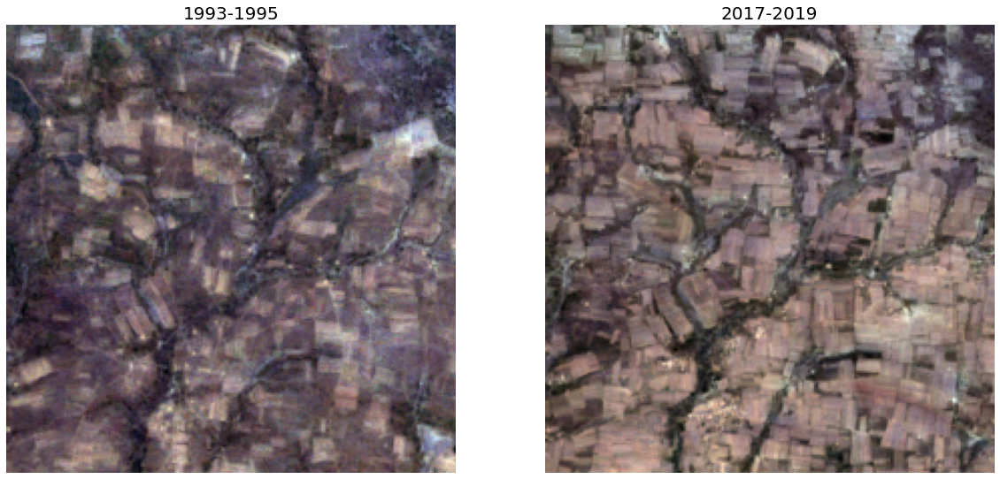

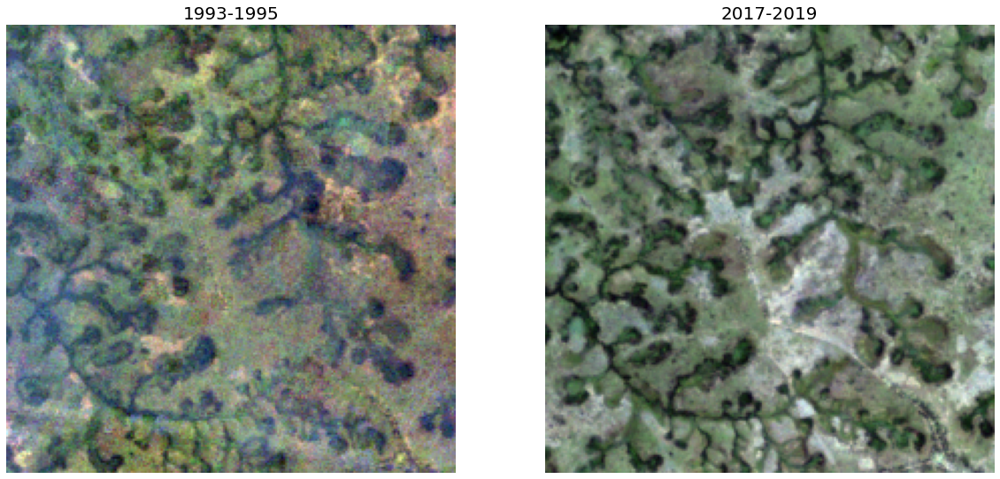

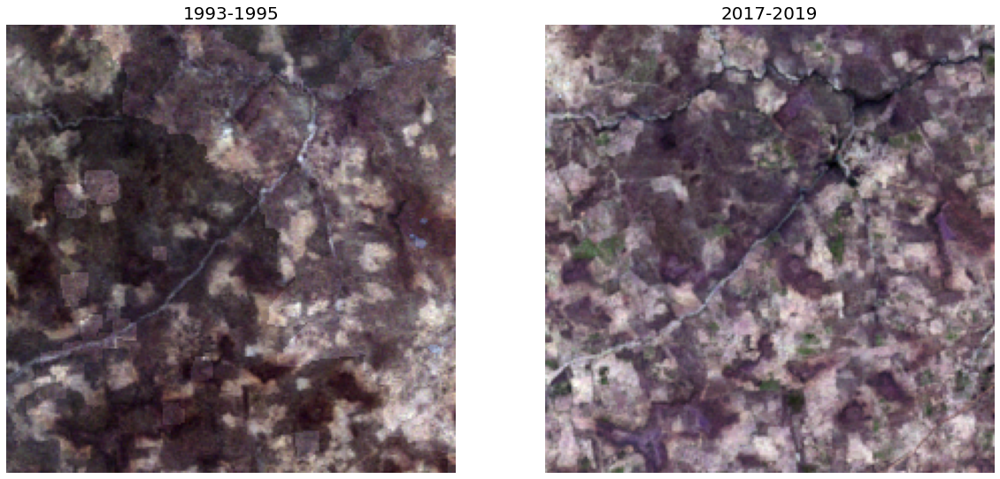

...

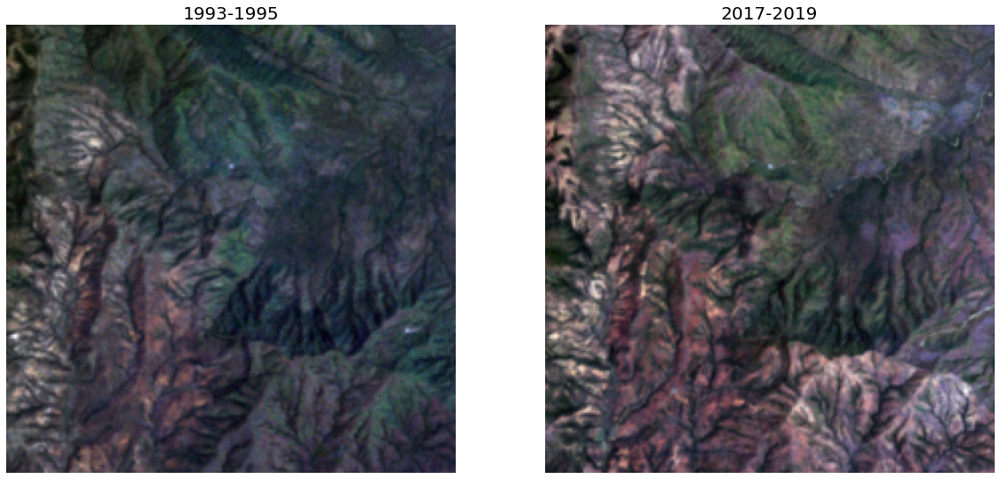

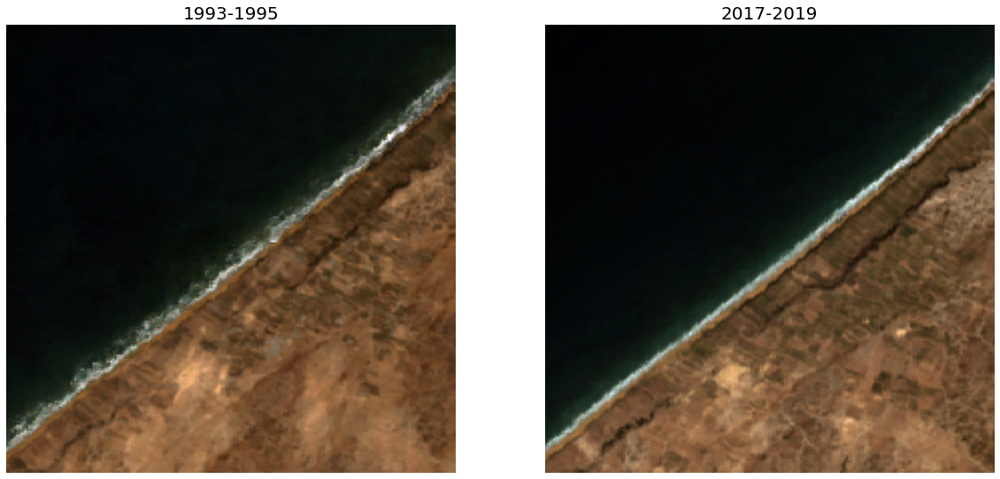

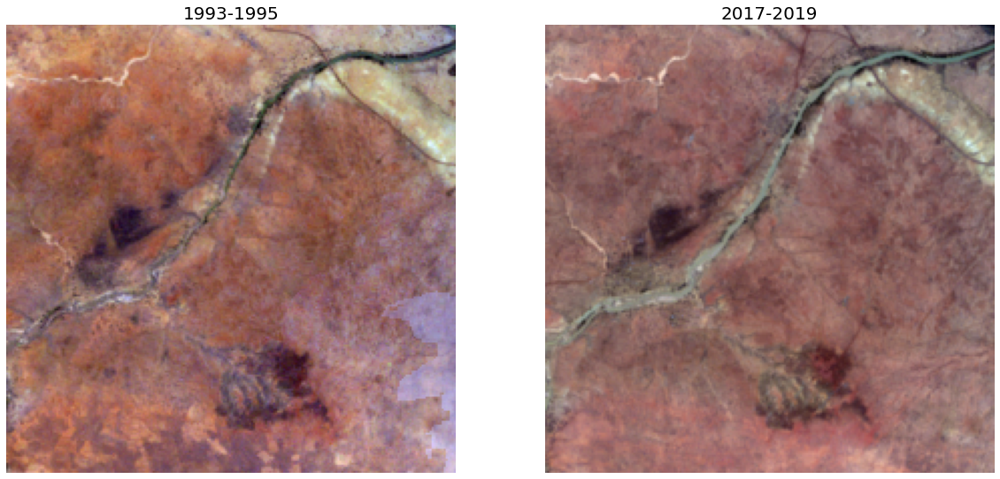

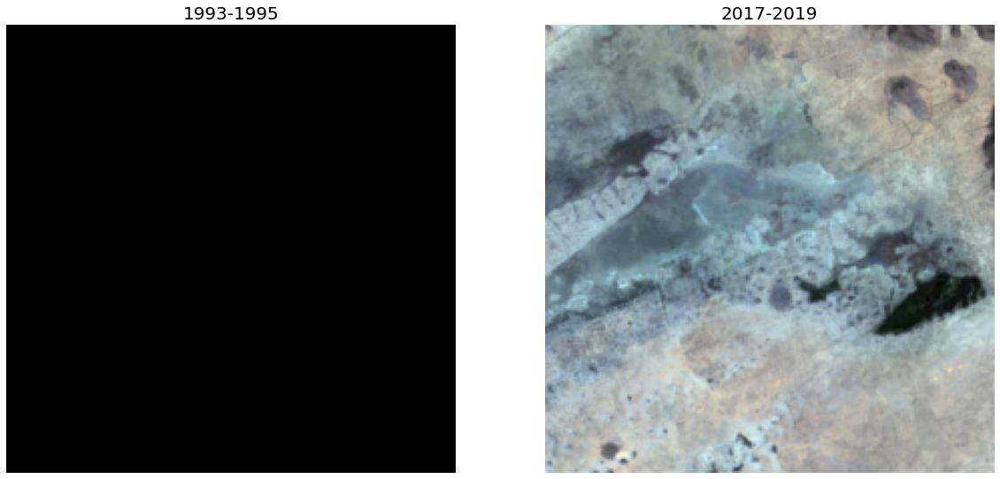

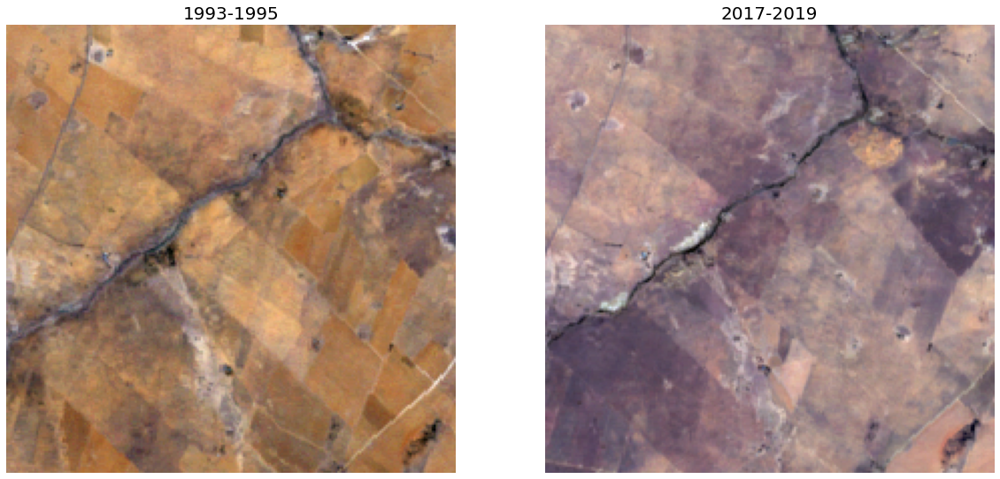

In [15]:
composite_n = 9

i_row = 0
for index, row in sample_imgs.iterrows():
    img_path = row.iloc[0]
    
    
    #print(img_path)
    
    img_src = rio.open(img_path)
    img_numpy = img_src.read()
    #img_tensor = torch.from_numpy(img_numpy)

    ## Select two different temporal composites
    # Select two timestamps
    t1, t2 = np.random.choice(a=9, size=2, replace=False)
    
    
    
    # REMOVES TEMPORALITY
    t1=1
    t2=9
    
    # Extract 8 corresponding bands for image 1 and 2
    img_t1 = img_numpy[8*t1 : 8*t1+8]
    img_t2 = img_numpy[8*t2 : 8*t2+8]

    # Transpose data from (CHW) format of PyTorch to fit (HWC) format of ALbumentations
    img_t1 = np.transpose(img_t1, (1,2,0))
    img_t2 = np.transpose(img_t2, (1,2,0))


    # Apply transformation to images separatelyy
    #img_t1 = aug_a(image=img_t1)['image']
    #img_t2 = aug_a(image=img_t2)['image']
    
    # NO AUGMENTATIONS
    img_t1 = aug(image=img_t1)['image']
    img_t2 = aug(image=img_t2)['image']
    
    #img_org = img_src.read([8*composite_n + 1, 8*composite_n + 2, 8*composite_n + 3])
    
    img_list = [img_t1.detach().numpy(), img_t2.detach().numpy()]
    composite_indices = [t1, t2]
    
    fig, (ax1, ax2) = plt.subplots(1, 2)
    axs = [ax1, ax2]
    #fig.suptitle('Horizontally stacked subplots')
    
    for i_img, img in enumerate(img_list):
        #if i_img == 0:
        #    first_img = img
            
        #band_max = [0] * 3
        #band_min = [0] * 3
        
        
        for i_band, band in enumerate(["BLUE", "GREEN", "RED"]):
            # "Unnormalize" images
            img[i_band] = (img[i_band] * band_stats["stds"][band]) + band_stats["means"][band]# + 0.15
            

        axs[i_img].axis('off')
        #if i_img == 0:
        #    axs[i_img].set_title('Original', fontsize=20)
        #else:
        #    axs[i_img].set_title('Augmented', fontsize=20)
        
        axs[i_img].set_title(index_to_year(composite_indices[i_img]), fontsize=20)
        
        show(img[(2,1,0),:,:], ax=axs[i_img], adjust=True)
        
        fig.show()
    
    #plt.axis('off')
    #show(img_src.read([8*composite_n + 3, 8*composite_n + 2, 8*composite_n + 1]), adjust=True)
    #plt.axis('off')
    #show(img_t1.detach().numpy()[(2,1,0),:,:], adjust=True)
    #plt.axis('off')
    #show(img_t2.detach().numpy()[(2,1,0),:,:], adjust=True)
    
    #print('________________________________________')
    i_row +=1
    #if i_row >= 50:
    #    break


